# Notebook for atom finding
## Using graph theory and light ML
### by Austin Houston, Aug 2025

Use the button below to run in colab:

[![OpenInColab](https://colab.research.google.com/assets/colab-badge.svg)](https://colab.research.google.com/github/AustinHouston/pyTEMlib/blob/main/notebooks/5_Atom_Finding.ipynb)

In [ ]:
# run this code cell first
!pip install ipympl
!pip install pyTEMlib

# when it's done, restart the kernel (Kernel -> Restart Kernel and Run All Cells...)

In [1]:
import os
import sys
import numpy as np

import pyTEMlib
import pyTEMlib.file_tools as ft
from pyTEMlib.atom_tools import atom_refine
print(pyTEMlib.__version__)

from scipy.ndimage import gaussian_filter
from skimage.feature import blob_log
from scipy.spatial import KDTree, ConvexHull, Delaunay
from scipy.signal import correlate, correlate2d
from sklearn.cluster import DBSCAN, KMeans
from sklearn.mixture import GaussianMixture
from skimage.filters import difference_of_gaussians

from collections import defaultdict, deque

# plotting
import matplotlib.pyplot as plt
import matplotlib.colors as colors
from matplotlib import colormaps as cm
from mpl_toolkits.mplot3d import Axes3D
import matplotlib.patches as patches
from matplotlib.path import Path
from shapely.geometry import Polygon, Point

# google drive related
if 'google.colab' in sys.modules:
    %matplotlib widget
    from google.colab import output
    output.enable_custom_widget_manager()

if 'google.colab' in sys.modules:
    drive.mount("/content/drive")


You don't have igor2 installed.     If you wish to open igor files, you will need to install it     (pip install igor2) before attempting.
You don't have gwyfile installed.     If you wish to open .gwy files, you will need to      install it (pip install gwyfile) before attempting.
Symmetry functions of spglib enabled
0.2025.03.0


### Choose dataset

In [11]:
# path to the folder in your google drive with all the data
file_path = '/Users/austin/Desktop/Projects/MoS2_isotope/MoS2_92_100/'

file_picker = ft.FileWidget(file_path)
# choose 0035 the first time through
# click the file, then click 'Select Main' button
# then go to next cell

In [16]:
dset = file_picker.datasets

image = dset['Channel_000']
image -= image.min()
image /= image.max()
pixel_size = image.x[1]

image

sidpy.Dataset of type IMAGE with:
 dask.array<truediv, shape=(2048, 4096), dtype=float64, chunksize=(2048, 4096), chunktype=numpy.ndarray>
 data contains: intensity (counts)
 and Dimensions: 
x:  distance (nm) of size (2048,)
y:  distance (nm) of size (4096,)
 with metadata: ['experiment', 'filename']

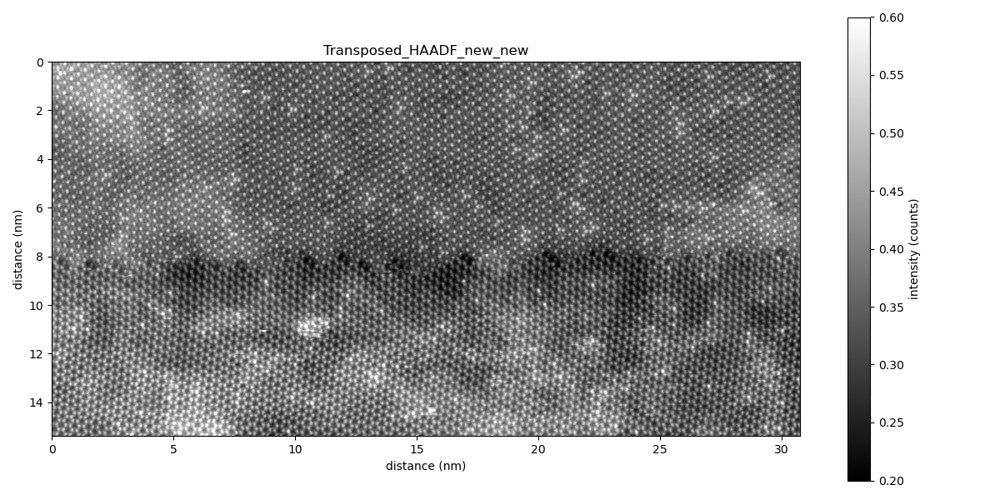

In [56]:
view = image.T.plot(figsize=(12,6), cmap='grey', vmin=0.2, vmax=0.6)


### Filter/ clean up the image

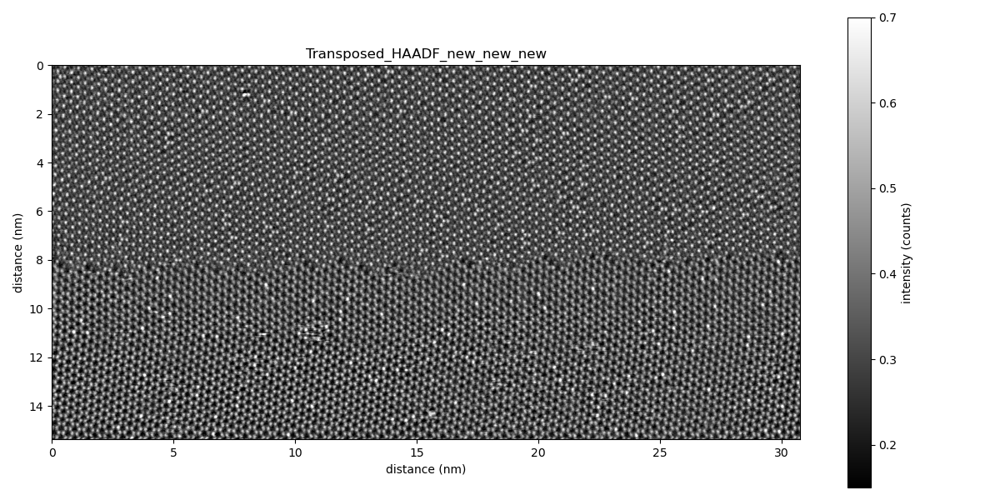

In [20]:
# difference of gaussians filtering
# this is a bandpass filter that removes low frequency background and high frequency noise
filtered = difference_of_gaussians(image, low_sigma = 1, high_sigma=20)
filtered -= filtered.min()
filtered /= filtered.max()

# convert back to sidpy dataset
filtered_dataset = image.like_data(filtered)

# visualize
view = filtered_dataset.T.plot(figsize=(12,6), cmap='grey', vmax=0.7, vmin=0.15)

  0%|          | 0/500 [00:00<?, ?it/s]

converged in 154 iterations

 Lucy-Richardson deconvolution converged in 154  iterations


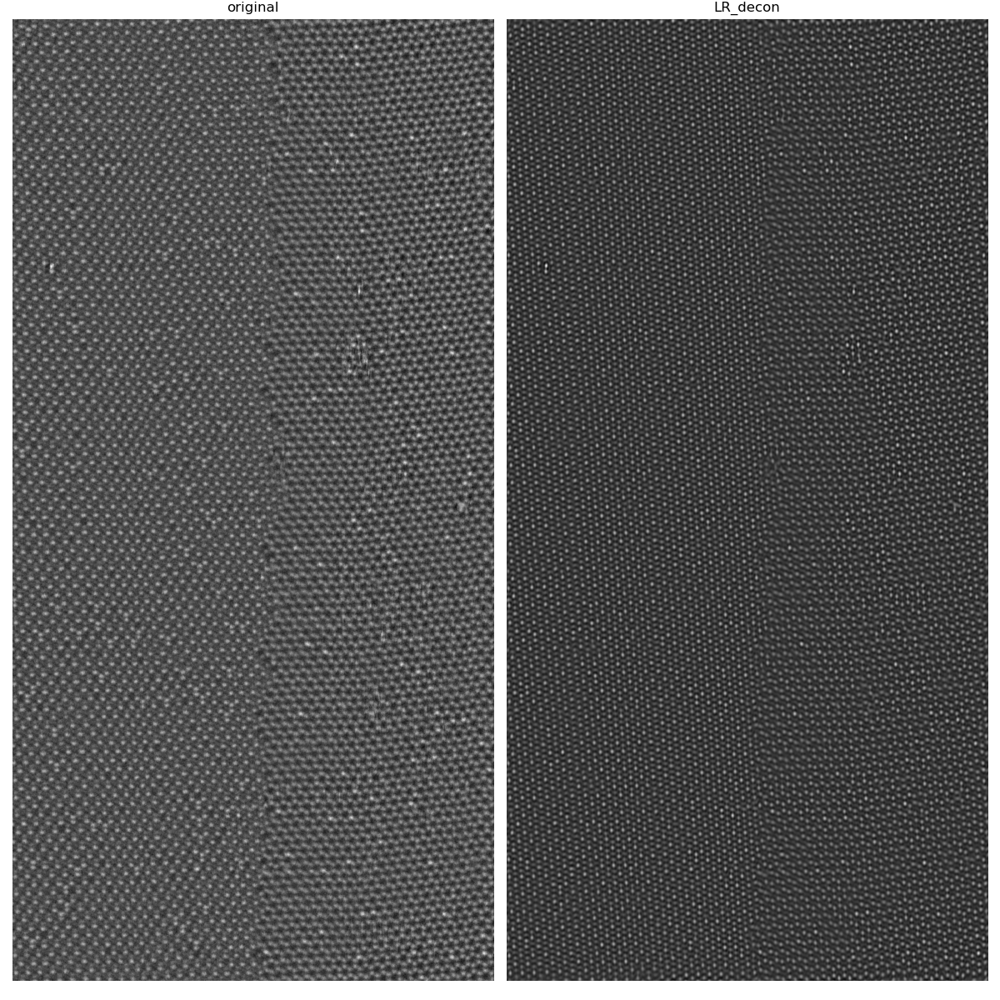

In [21]:
def make_gauss(size_x, size_y, width=1.0, x0=0.0, y0=0.0, intensity=1.0):
    """Make a Gaussian shaped probe """
    size_x = size_x / 2
    size_y = size_y / 2
    x, y = np.mgrid[-size_x:size_x, -size_y:size_y]
    g = np.exp(-((x - x0) ** 2 + (y - y0) ** 2) / 2.0 / width ** 2)
    probe = g / g.sum() * intensity
    return probe

# try changing this parameter to see how it affects the deconvolution (8.5 is a good starting point)
gauss_diameter = 8.5
filtered_dataset.metadata['experiment']= {'convergence_angle': 30, 'acceleration_voltage': 60000.}
gauss_probe = make_gauss(filtered_dataset.shape[0], filtered_dataset.shape[1], gauss_diameter)
lr_dataset = it.decon_lr(filtered_dataset, gauss_probe, verbose=False)

# visualization
fig, ax = plt.subplots(1,2, figsize=(12, 12), sharex=True, sharey=True)
ax[0].imshow(filtered_dataset.T, cmap='grey')
ax[0].set_title('original')
ax[1].imshow(lr_dataset.T, cmap='grey')
ax[1].set_title('LR_decon')
for a in ax:
    a.axis('off')
fig.tight_layout()



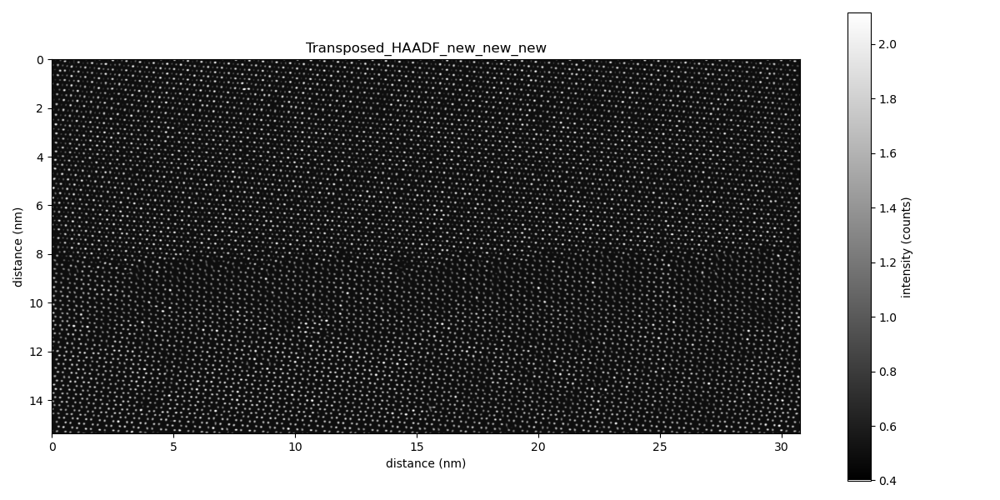

In [27]:
# Clip any bright pixels that may be artifacts
p99 = np.percentile(np.array(lr_dataset).ravel(), 99.9)
clipped_image = np.clip(np.array(lr_dataset), 0.5, p99)
final_image = image.like_data(clipped_image)

# Visualization
view = final_image.T.plot(figsize = (12,6), cmap='gray', vmin=0.4)


### Now, Atom finding

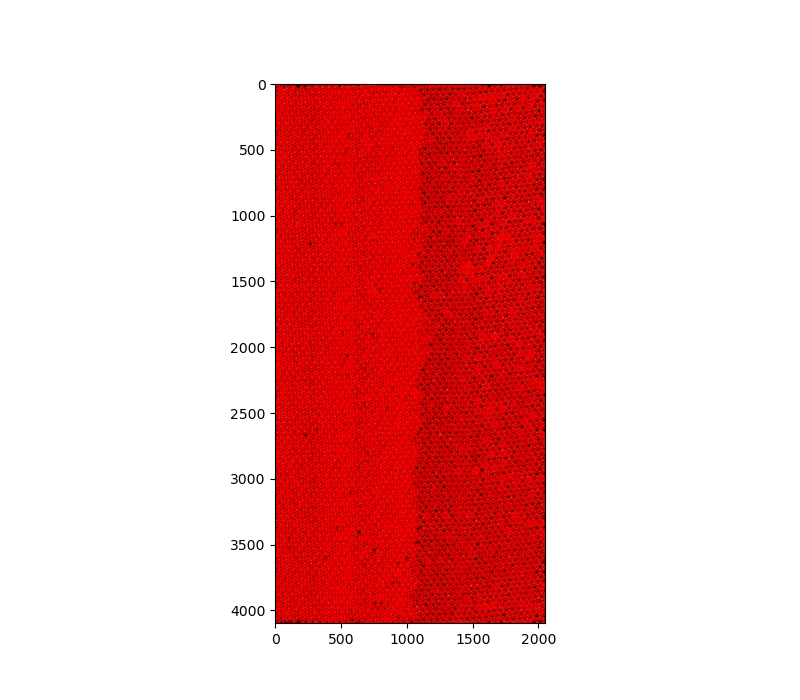

In [31]:
# first approximation blob finder

# ------- Input ------
threshold = 0.2 #usally between 0.01 and 0.9  the smaller the more atoms 0.05
atom_size = 0.1 #in nm 
# ----------------------
# atom_size/pixel_size
blobs = blob_log(lr_dataset, max_sigma=3, threshold=threshold)

fig, ax = plt.subplots(1, 1,figsize=(8,7), sharex=True, sharey=True)
ax.imshow(final_image.T, cmap='gray')
ax.scatter(blobs[:, 0], blobs[:, 1], c='r', s=10, alpha = .5)


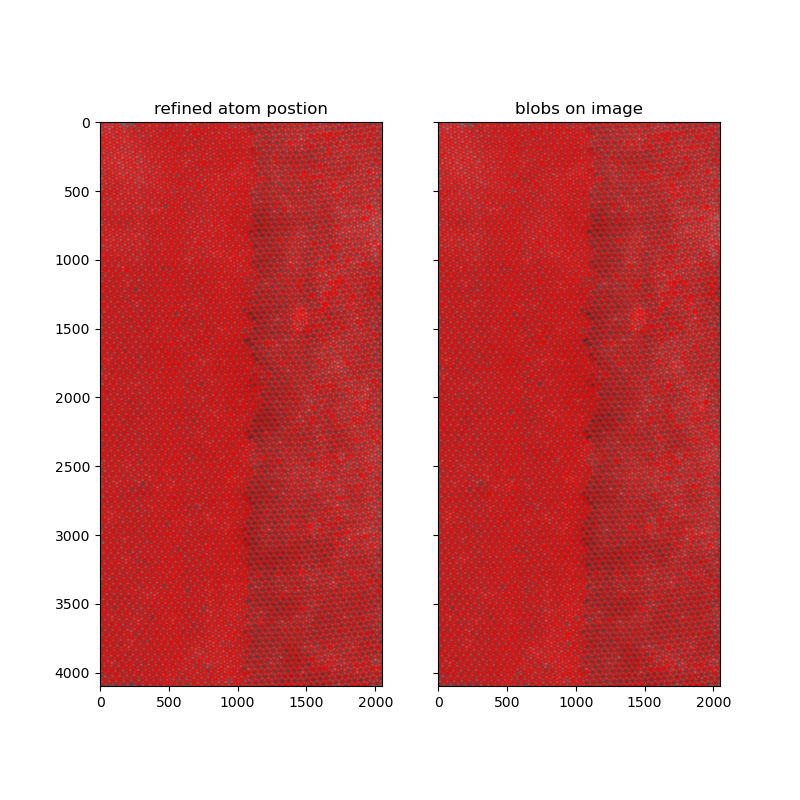

In [32]:
# refine the atoms with subpixel accuracy

# ------- Input ------
atom_radius = 3  # in pixel
# ----------------------

sym = atom_refine(np.array(final_image), blobs, atom_radius, max_int = 0, min_int = 0, max_dist = 2)
refined_atoms = np.array(sym['atoms'])
intensities = np.array(sym['intensity_area'])

fig, ax = plt.subplots(1, 2, figsize=(8, 8), sharex=True, sharey=True)
ax[0].imshow(image.T, cmap = 'gray')
ax[0].scatter(refined_atoms[:,0],refined_atoms[:,1],  s=10, alpha = 0.3, color = 'red')
ax[0].set_title('refined atom postion')
ax[1].imshow(image.T, cmap = 'gray')
ax[1].scatter(blobs[:, 0], blobs[:, 1], c='r', s=10, alpha = .3);
ax[1].set_title('blobs on image');


In [33]:
def reconstruct_image(atoms, intensities, shape, sigma=1.0):
    reconstructed_image = np.zeros(shape, dtype=np.float32)

    for (x, y), intensity in zip(atoms, intensities):
        # if intensity < 1:  # Ignore invalid atoms or zero intensity
            # Create a delta function at the sub-pixel position
        x_int, y_int = int(x), int(y)
        if 0 <= x_int < shape[0] and 0 <= y_int < shape[1]:
            fractional_x, fractional_y = x - x_int, y - y_int
            reconstructed_image[x_int, y_int] += intensity * (1 - fractional_x) * (1 - fractional_y)
            if x_int + 1 < shape[0]:
                reconstructed_image[x_int + 1, y_int] += intensity * fractional_x * (1 - fractional_y)
            if y_int + 1 < shape[1]:
                reconstructed_image[x_int, y_int + 1] += intensity * (1 - fractional_x) * fractional_y
            if x_int + 1 < shape[0] and y_int + 1 < shape[1]:
                reconstructed_image[x_int + 1, y_int + 1] += intensity * fractional_x * fractional_y

    # Apply Gaussian smoothing to simulate the Gaussian spread
    reconstructed_image = gaussian_filter(reconstructed_image, sigma=sigma, mode='constant')

    return reconstructed_image

(-0.5, 4095.5, 2047.5, -0.5)

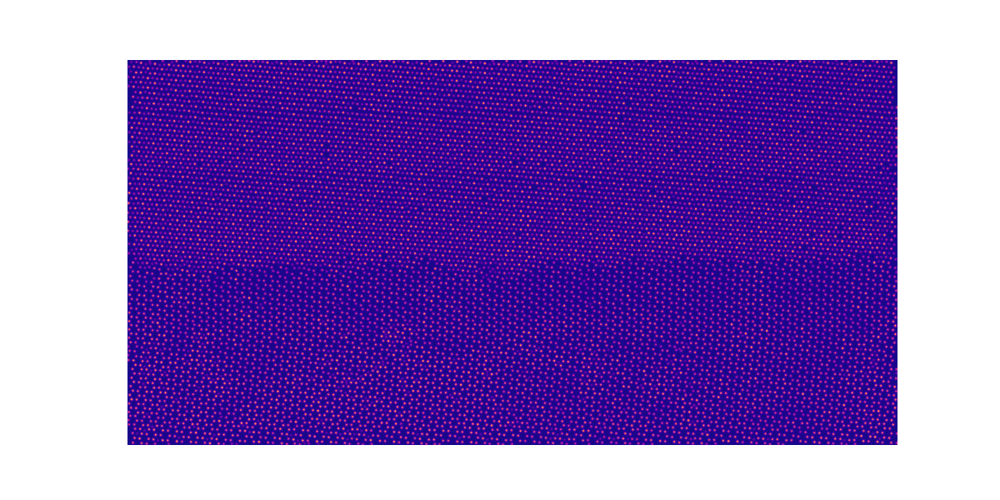

In [34]:
# This will not be perfect the first time through - that's okay

recon = reconstruct_image(refined_atoms, intensities, image.shape, sigma=4)
recon = recon - recon.min()
recon = recon/recon.max()

plt.figure(figsize=(12, 6))
plt.imshow(recon, cmap='plasma')
plt.axis('off')

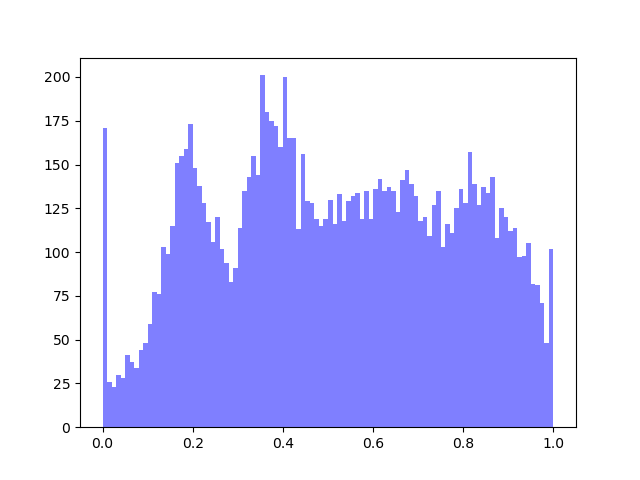

In [35]:
intensity = np.array(sym['intensity_area'])
atoms = np.array(sym['atoms'])

# remove atoms and intensities where intensiy < 0
atoms = atoms[intensity > 0]
intensity = intensity[intensity > 0]

intensity -= intensity.min()
intensity = intensity/intensity.max()

plt.figure()
plt.hist(intensity, bins=100, alpha = 0.5, color = 'blue', label = 'intensity_area');


In [36]:
# Build KDTree and find 6 nearest neighbors
tree = KDTree(atoms)
distances, indices = tree.query(atoms, k=8)  # k=7 includes self and 6 neighbors
neighbor_ids = indices[:, 1:]  # Exclude self (first neighbor)

nn_vectors = []
for i in range(len(atoms)):
    atom = atoms[i]
    neighbors = atoms[neighbor_ids[i]]  # Get the 6 nearest neighbors
    vectors = neighbors - atom  # Compute vectors to neighbors
    nn_vectors.append(vectors)
nn_vectors = np.array(nn_vectors)  # Shape: (num_atoms, 6, 2)

# KMeans clustering
reshaped_nn_vectors = nn_vectors.reshape(-1, 2)  # Shape: (num_atoms * 6, 2)
num_clusters = 12  # Choose the desired number of clusters
kmeans = KMeans(n_clusters=num_clusters, random_state=0)
kmeans.fit(reshaped_nn_vectors)
cluster_labels = kmeans.labels_.reshape(nn_vectors.shape[:2])  # Shape: (num_atoms, 6)
cluster_centers = kmeans.cluster_centers_  # Shape: (num_clusters, 2)
nn_vecs = np.array(cluster_centers)

# sort and group by distance
nn_dists = np.linalg.norm(nn_vecs, axis=1)
sorted_indices = np.argsort(nn_dists)
nn_vecs = nn_vecs[sorted_indices]

nnn_vecs = nn_vecs[6:,:]
nn_vecs = nn_vecs[:6,:]

stepper_vecs = nnn_vecs.copy()

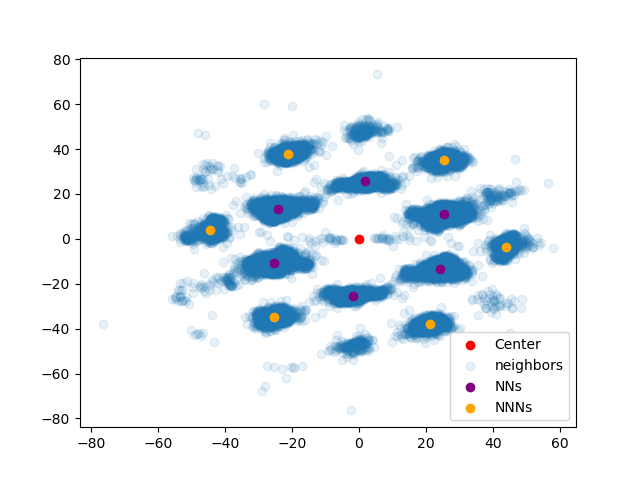

In [37]:
plt.figure()
plt.scatter(0, 0, c='r', label='Center')
plt.scatter(nn_vectors[:, :, 0], nn_vectors[:, :, 1], alpha=0.1, label='neighbors')
plt.scatter(nn_vecs[:, 0], nn_vecs[:, 1], c='purple', label='NNs')
plt.scatter(nnn_vecs[:, 0], nnn_vecs[:, 1], c='orange', label='NNNs')
plt.legend()

3293


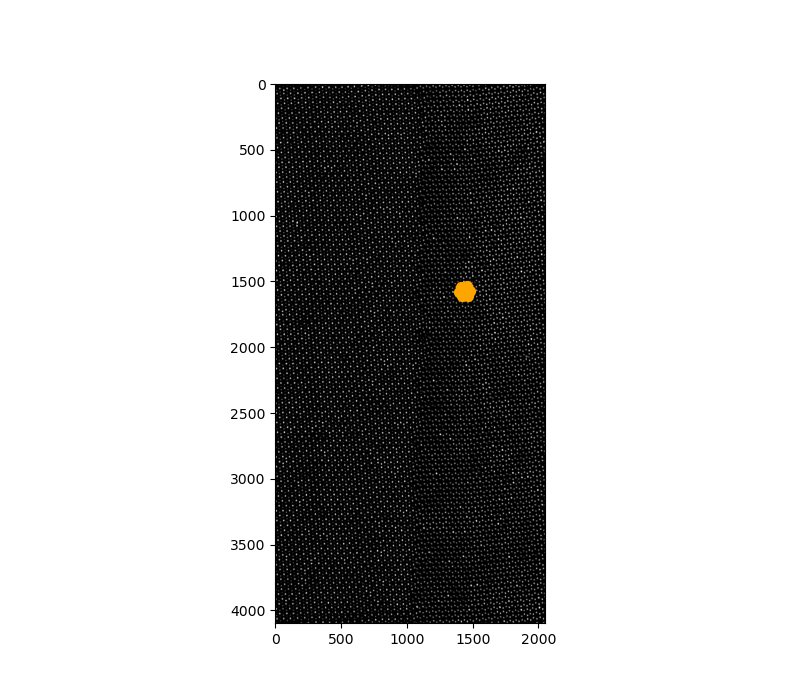

In [38]:
# code cell for testing starting nodes and choice of stepper_vecs
target_point_coords = np.array([1436, 1576])

closest_atom_idx = np.argmin(np.linalg.norm(atoms - target_point_coords, axis=1))
print(closest_atom_idx)


start_node = closest_atom_idx

fig, ax = plt.subplots(1, 1,figsize=(8,7), sharex=True, sharey=True)
ax.imshow(final_image.T, cmap='gray')

# scatter start node
ax.scatter(atoms[start_node, 0], atoms[start_node, 1], c='r', s=50, label='Start Node')

# scatter start node + NNs
for i, vec in enumerate(stepper_vecs):
    ax.scatter(atoms[start_node, 0] + vec[0], atoms[start_node, 1] + vec[1], c='orange', s=50, label=f'NN {i+1}')


In [39]:
def breadth_first_search(points, start_node, stepper_vecs, tolerance, edges=10, return_empties=False):
    graph = defaultdict(list)
    for i in range(len(points)):
        for j in indices[i][1:]:  # Connect current node to all neighbors (exclude self)
            graph[i].append(j)

    # traversal using BFS
    visited = set()  # Keep track of visited nodes
    empties = []  # Store vacancies
    queue = deque([start_node])
    visited.add(start_node)
    while queue:
        current_node = queue.popleft()
        current_point = points[current_node]
        
        # Check all possible neighbor directions
        for vector in stepper_vecs:
            expected_pos = current_point + vector
            dist, idx = tree.query(expected_pos)

            if dist > tolerance:  # Empty detected
                empties.append(expected_pos)
            elif idx not in visited:  # Valid neighbor found
                visited.add(idx)
                queue.append(idx)

    visited_nodes = np.array(points[list(visited)])

    x_min, y_min = points.min(axis=0) + edges
    x_max, y_max = points.max(axis=0) - edges

    if return_empties:
        empties = np.array(empties)
        empties = empties[(empties[:, 0] > x_min) & (empties[:, 0] < x_max) & (empties[:, 1] > y_min) & (empties[:, 1] < y_max)]
        return visited_nodes, empties

    else:
        visited_nodes = visited_nodes[(visited_nodes[:, 0] > x_min) & (visited_nodes[:, 0] < x_max) & (visited_nodes[:, 1] > y_min) & (visited_nodes[:, 1] < y_max)]
        return visited_nodes



In [40]:
# monolayer metal atoms
start_node = 3973
lattice_1 = breadth_first_search(atoms, start_node=start_node, stepper_vecs=stepper_vecs, tolerance=8, edges=10, return_empties=False)

# monolayer chalcs
start_node = 3293
lattice_2 = breadth_first_search(atoms, start_node=start_node, stepper_vecs=stepper_vecs, tolerance=8, edges=10, return_empties=False)

# secondl layer S, left
start_node = 8179
lattice_3 = breadth_first_search(atoms, start_node=start_node, stepper_vecs=stepper_vecs, tolerance=8, edges=10, return_empties=False)


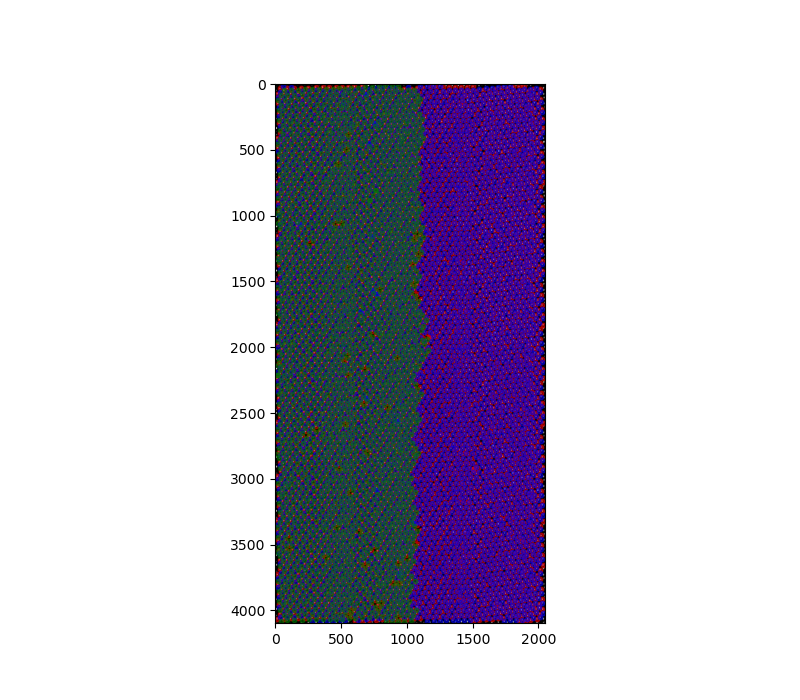

In [41]:
fig, ax = plt.subplots(1, 1,figsize=(8,7), sharex=True, sharey=True)
ax.imshow(final_image.T, cmap='gray')

plt.scatter(lattice_1[:,0],lattice_1[:,1], color = 'red', s=10, alpha=0.5)
plt.scatter(lattice_2[:,0],lattice_2[:,1], color = 'blue', s=10, alpha=0.5)
plt.scatter(lattice_3[:,0],lattice_3[:,1], color = 'green', s=10, alpha=0.5)

In [42]:
atom_radius = 3
sym = atom_refine(np.array(final_image), lattice_1, atom_radius, max_int = 0, min_int = 0, max_dist = 2)
pos_l1 = np.array(sym['atoms'])
int_l1 = np.array(sym['intensity_area'])

sym = atom_refine(np.array(final_image), lattice_2, atom_radius, max_int = 0, min_int = 0, max_dist = 2)
pos_l2 = np.array(sym['atoms'])
int_l2 = np.array(sym['intensity_area'])

sym = atom_refine(np.array(final_image), lattice_3, atom_radius, max_int = 0, min_int = 0, max_dist = 2)
pos_l3 = np.array(sym['atoms'])
int_l3 = np.array(sym['intensity_area'])


using radius  3 pixels


  0%|          | 0/4552 [00:00<?, ?it/s]

/Users/austin/miniconda3/envs/pytemlib_2025/lib/python3.11/site-packages/pyTEMlib/probe_tools.py:17: RuntimeWarning: invalid value encountered in divide
  probe = g / g.sum() * intensity


using radius  3 pixels


  0%|          | 0/4502 [00:00<?, ?it/s]

using radius  3 pixels


  0%|          | 0/2347 [00:00<?, ?it/s]

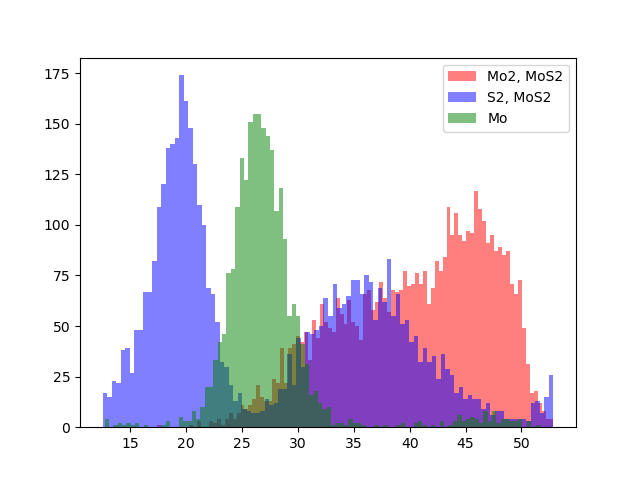

In [43]:
plt.figure()
plt.hist(int_l1, color='red', alpha = 0.5, bins=100, label='Mo2, MoS2');
plt.hist(int_l2, color='blue', alpha = 0.5, bins=100, label='S2, MoS2');
plt.hist(int_l3, color='green', alpha = 0.5, bins=100, label='Mo');
plt.legend()

In [44]:
# sort out lat 2
# if two atoms are within cutoff = 11 pixels of eachother, average their position, and refilter like this:
from scipy.spatial import distance_matrix

cutoff = 11
dists = distance_matrix(pos_l2, pos_l2)
np.fill_diagonal(dists, np.inf)  # avoid self-matching

to_merge = []
visited = set()

for i in range(len(pos_l2)):
    if i in visited:
        continue
    close = np.where(dists[i] < cutoff)[0]
    group = [i] + [j for j in close if j not in visited]
    visited.update(group)
    to_merge.append(group)

# Average positions and intensities
merged_pos = []
merged_int = []

for group in to_merge:
    merged_pos.append(np.mean(pos_l2[group], axis=0))
    merged_int.append(np.mean(int_l2[group]))

merged_pos = np.array(merged_pos)
merged_int = np.array(merged_int)

# Rerun filtering
sym = atom_refine(np.array(final_image), merged_pos, atom_radius, max_int=0, min_int=0, max_dist=2)
pos_l2 = np.array(sym['atoms'])
int_l2 = np.array(sym['intensity_area'])

using radius  3 pixels


  0%|          | 0/4490 [00:00<?, ?it/s]

/var/folders/1h/36qxtl8567zdjv8nzdn4fzrr0000gn/T/ipykernel_45956/4180494154.py:1: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots(1, 1,figsize=(8,7), sharex=True, sharey=True)


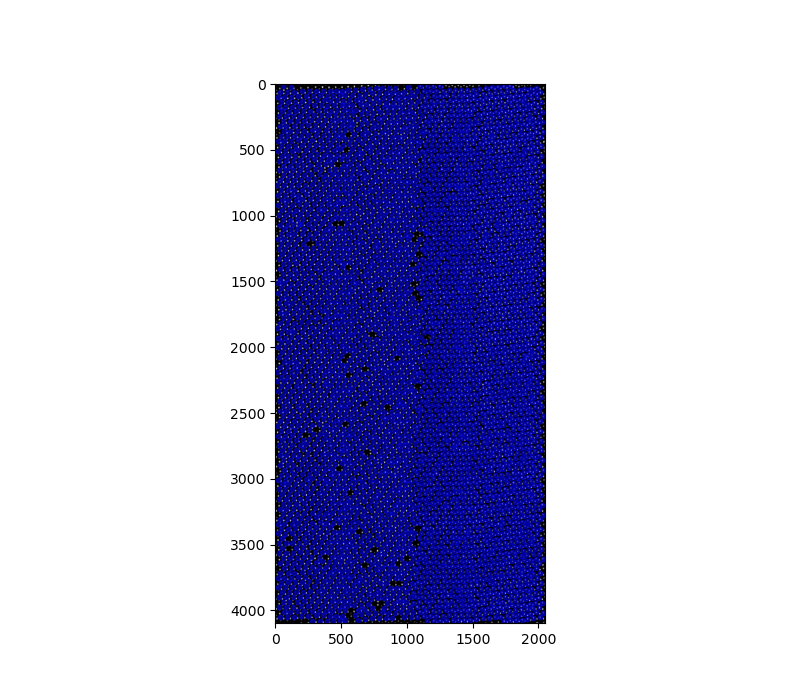

In [45]:
fig, ax = plt.subplots(1, 1,figsize=(8,7), sharex=True, sharey=True)
ax.imshow(final_image.T, cmap='gray')

plt.scatter(pos_l2[:,0],pos_l2[:,1], color = 'blue', s=10, alpha=0.5)

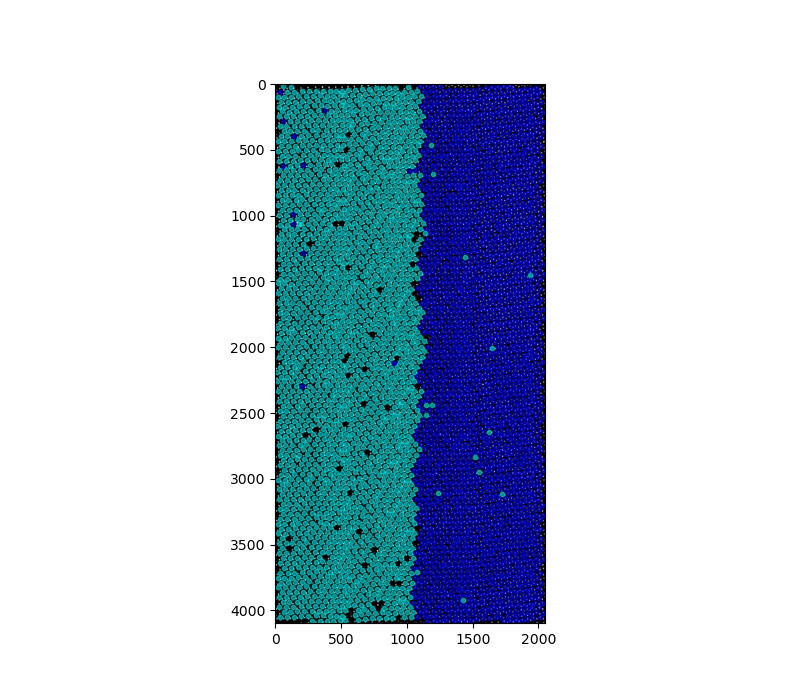

In [46]:
int_cutoff = 26

bilayer_l2 = pos_l2[int_l2 > int_cutoff]
monolayer_l2 = pos_l2[int_l2 <= int_cutoff]

fig, ax = plt.subplots(1, 1,figsize=(8,7), sharex=True, sharey=True)
ax.imshow(final_image.T, cmap='gray')

plt.scatter(bilayer_l2[:,0],bilayer_l2[:,1], color = 'blue', s=10, alpha=0.5)
plt.scatter(monolayer_l2[:,0],monolayer_l2[:,1], color = 'cyan', s=10, alpha=0.5)

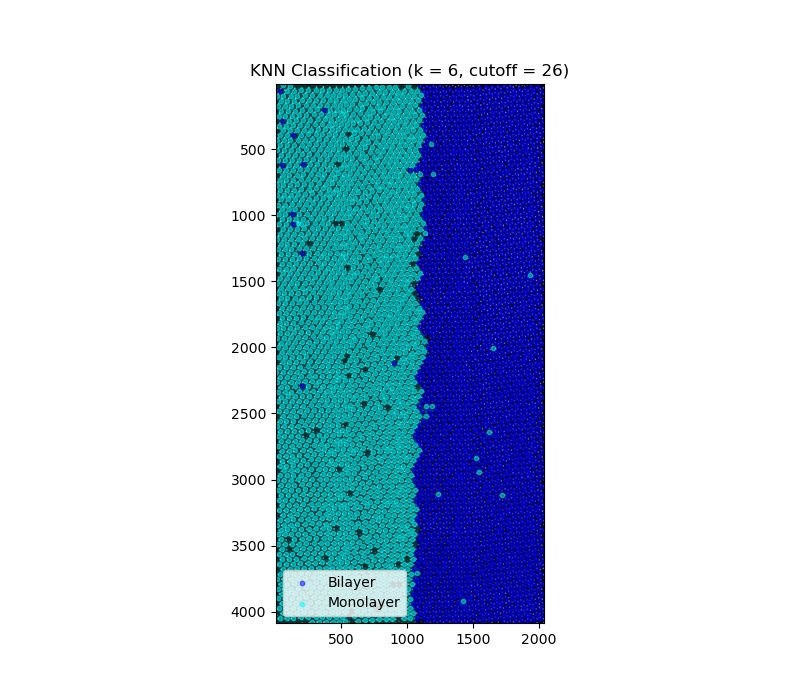

In [47]:
from sklearn.neighbors import KNeighborsClassifier

# Data: positions (X) and binary labels (y)
X = pos_l2  # shape: (N, 2)
y = (int_l2 > int_cutoff).astype(int)  # 1 = bilayer, 0 = monolayer

# Train KNN
knn = KNeighborsClassifier(n_neighbors=6)  # you can tweak n_neighbors
knn.fit(X, y)

# Grid for visualization
x_min, x_max = X[:, 0].min() - 5, X[:, 0].max() + 5
y_min, y_max = X[:, 1].min() - 5, X[:, 1].max() + 5
xx, yy = np.meshgrid(np.linspace(x_min, x_max, 500),
                     np.linspace(y_min, y_max, 500))

# Predict on grid
Z = knn.predict(np.c_[xx.ravel(), yy.ravel()])
Z = Z.reshape(xx.shape)

# Plot
fig, ax = plt.subplots(1, 1, figsize=(8, 7))
ax.imshow(final_image.T, cmap='gray', extent=(x_min, x_max, y_max, y_min))
ax.contourf(xx, yy, Z, alpha=0.2, levels=1, colors=['cyan', 'blue'])

# Plot points
ax.scatter(X[y == 1, 0], X[y == 1, 1], color='blue', s=10, alpha=0.5, label='Bilayer')
ax.scatter(X[y == 0, 0], X[y == 0, 1], color='cyan', s=10, alpha=0.5, label='Monolayer')

ax.legend()
plt.title(f'KNN Classification (k = 6, cutoff = {int_cutoff})')
plt.show()

In [48]:
# Step 2: Predict bilayer/monolayer labels for l1 and l3
labels_l1 = knn.predict(pos_l1)
labels_l2 = knn.predict(pos_l2)
labels_l3 = knn.predict(pos_l3)

# Optional: get probabilities instead
proba_l1 = knn.predict_proba(pos_l1)[:,1]  # bilayer probability
proba_l2 = knn.predict_proba(pos_l2)[:,1]
proba_l3 = knn.predict_proba(pos_l3)[:,1]

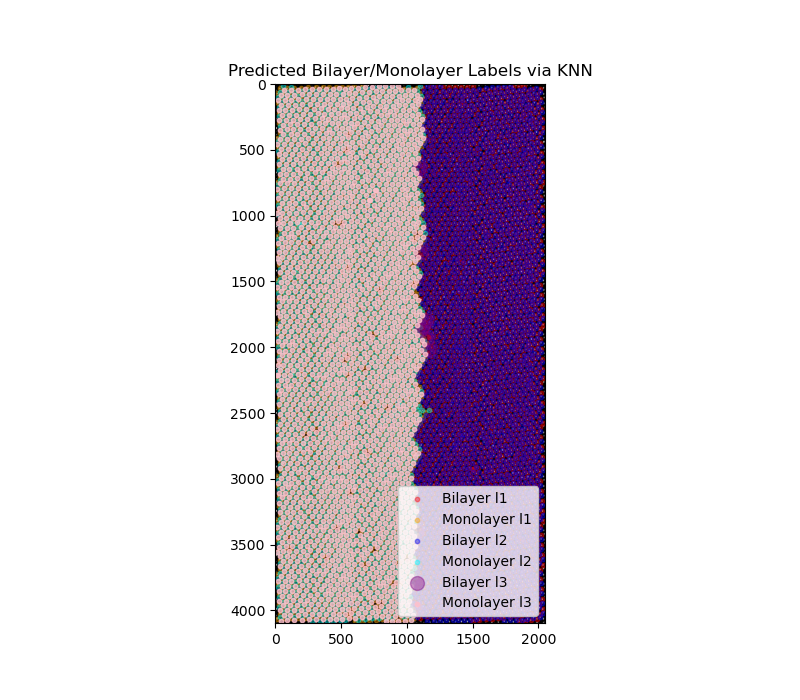

In [49]:
fig, ax = plt.subplots(1, 1, figsize=(8,7))
ax.imshow(final_image.T, cmap='gray')

# Show predictions for l1 and l3

# call these "Mo_bottom_right, S_top_right"
ax.scatter(pos_l1[labels_l1 == 1,0], pos_l1[labels_l1 == 1,1], s=10, c='red', alpha=0.4, label='Bilayer l1')
# call these "S_top_left, Mo_bottom_left"
ax.scatter(pos_l1[labels_l1 == 0,0], pos_l1[labels_l1 == 0,1], s=10, c='orange', alpha=0.4, label='Monolayer l1')

# call these "Mo_top_right, S_bottom_right"
ax.scatter(pos_l2[labels_l2 == 1,0], pos_l2[labels_l2 == 1,1], s=10, c='blue', alpha=0.4, label='Bilayer l2')
# call these "S_bottom_left"
ax.scatter(pos_l2[labels_l2 == 0,0], pos_l2[labels_l2 == 0,1], s=10, c='cyan', alpha=0.4, label='Monolayer l2')

ax.scatter(pos_l3[labels_l3 == 1,0], pos_l3[labels_l3 == 1,1], s=100, c='purple', alpha=0.4, label='Bilayer l3')
# call these "Mo_top_left"
ax.scatter(pos_l3[labels_l3 == 0,0], pos_l3[labels_l3 == 0,1], s=10, c='pink', alpha=0.8, label='Monolayer l3')

ax.legend()
plt.title("Predicted Bilayer/Monolayer Labels via KNN")
plt.show()


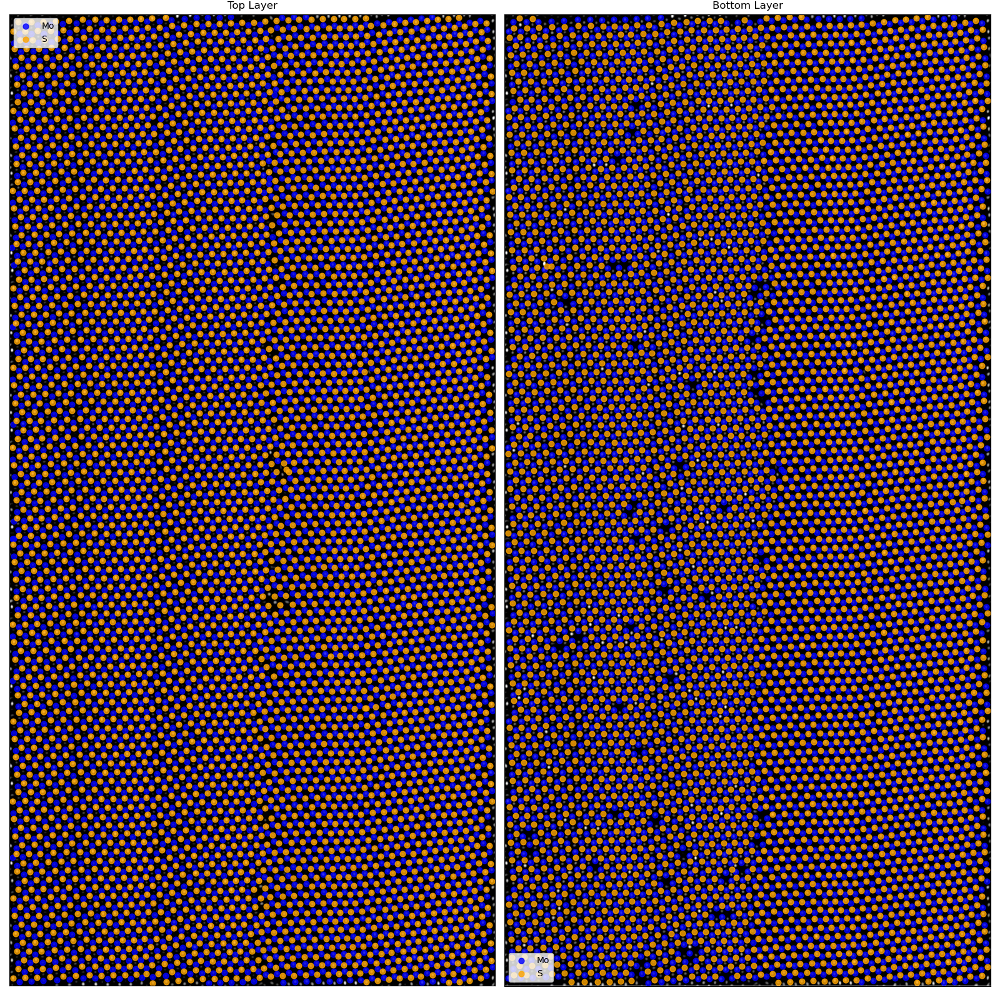

In [50]:
# Create labeled arrays from KNN predictions
Mo_bottom_right = pos_l1[labels_l1 == 1]
S_top_right = pos_l1[labels_l1 == 1]

S_top_left = pos_l1[labels_l1 == 0]
Mo_bottom_left = pos_l1[labels_l1 == 0]

Mo_top_right = pos_l2[labels_l2 == 1]
S_bottom_right = pos_l2[labels_l2 == 1]

S_bottom_left = pos_l2[labels_l2 == 0]

Mo_top_left   = pos_l3[labels_l3 == 0]


# For visualization: make one subplot for top atoms, one for bottom atoms
fig, ax = plt.subplots(1, 2, figsize=(16, 16), sharex=True, sharey=True)

# Show the background image
for a in ax:
    a.imshow(final_image.T, cmap='gray')
    a.set_xticks([])
    a.set_yticks([])

# Left panel: Mo and S top
ax[0].scatter(Mo_top_right[:, 0], Mo_top_right[:, 1], s=40, c='blue',    alpha=0.8, label='Mo')
ax[0].scatter(Mo_top_left[:, 0],   Mo_top_left[:, 1],  s=40, c='blue',   alpha=0.8)

ax[0].scatter(S_top_right[:, 0], S_top_right[:, 1], s=40, c='orange',    alpha=0.8, label='S')
ax[0].scatter(S_top_left[:, 0],   S_top_left[:, 1],  s=40, c='orange',   alpha=0.8)

ax[0].set_title("Top Layer")
ax[0].legend()

# Right panel: Mo and S bottom
ax[1].scatter(Mo_bottom_right[:, 0], Mo_bottom_right[:, 1], s=40, c='blue',    alpha=0.8, label='Mo')
ax[1].scatter(Mo_bottom_left[:, 0],   Mo_bottom_left[:, 1],  s=40, c='blue',   alpha=0.8)

ax[1].scatter(S_bottom_right[:, 0], S_bottom_right[:, 1], s=40, c='orange',    alpha=0.8, label='S')
ax[1].scatter(S_bottom_left[:, 0],   S_bottom_left[:, 1],  s=40, c='orange',   alpha=0.8)


ax[1].set_title("Bottom Layer")
ax[1].legend()

plt.tight_layout()
plt.show()

(-0.5, 4095.5, 2047.5, -0.5)

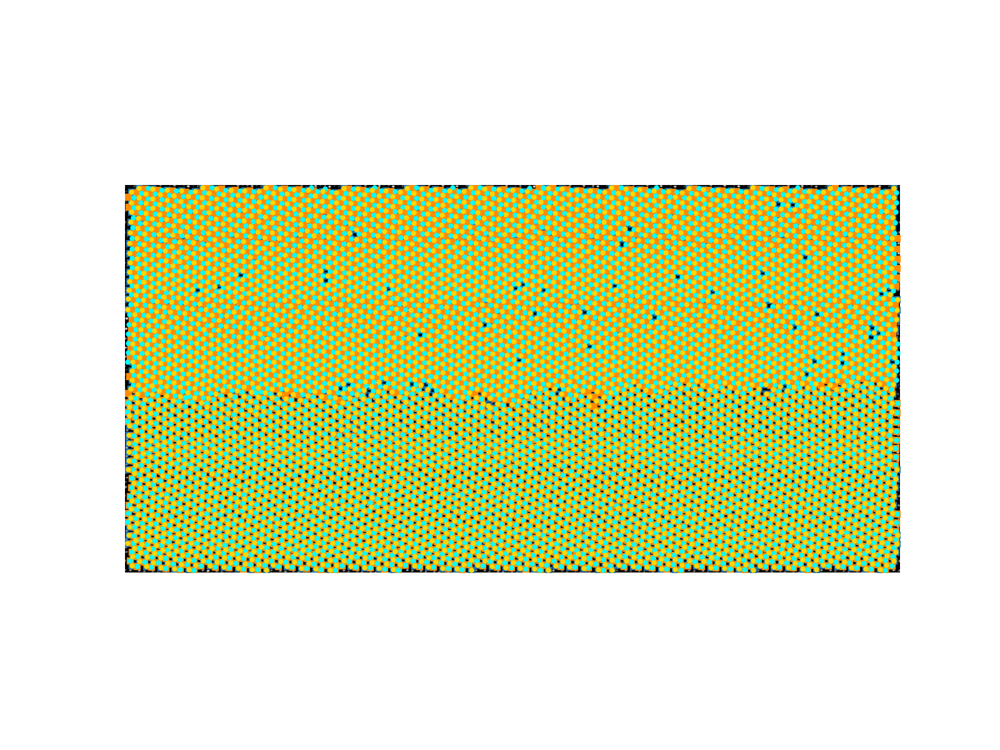

In [51]:
# For visualization: make one subplot for top atoms, one for bottom atoms
master_alpha = 1

fig, ax = plt.subplots(1, 1, figsize=(16, 12))
ax.imshow(final_image, cmap='gray')


# Bottom
# draw a small white line from every point in bottom to every nearby point within 30 pixels

marker = 's'
size = 50
ax.scatter(Mo_bottom_right[:, 1], Mo_bottom_right[:, 0], s=size, c='tab:blue',    alpha=master_alpha, marker=marker)
ax.scatter(Mo_bottom_left[:, 1],   Mo_bottom_left[:, 0],  s=size, c='tab:blue',   alpha=master_alpha, marker=marker)

ax.scatter(S_bottom_right[:, 1], S_bottom_right[:, 0], s=size, c='darkorange',    alpha=master_alpha, marker=marker)
ax.scatter(S_bottom_left[:, 1],   S_bottom_left[:, 0],  s=size, c='darkorange',   alpha=master_alpha, marker=marker)

# top
# draw a small white line from every point in top to every nearby point within 30 pixels
marker = 'o'
size = 25
ax.scatter(Mo_top_right[:, 1], Mo_top_right[:, 0], s=size, c='cyan',    alpha=master_alpha, marker=marker)
ax.scatter(Mo_top_left[:, 1],   Mo_top_left[:, 0],  s=size, c='cyan',   alpha=master_alpha, marker=marker)

ax.scatter(S_top_right[:, 1], S_top_right[:, 0], s=size, c='gold',    alpha=master_alpha, marker=marker)
ax.scatter(S_top_left[:, 1],   S_top_left[:, 0],  s=size, c='gold',   alpha=master_alpha, marker=marker)


ax.axis('off')

In [52]:
final_image -= final_image.min()
final_image /= final_image.max()

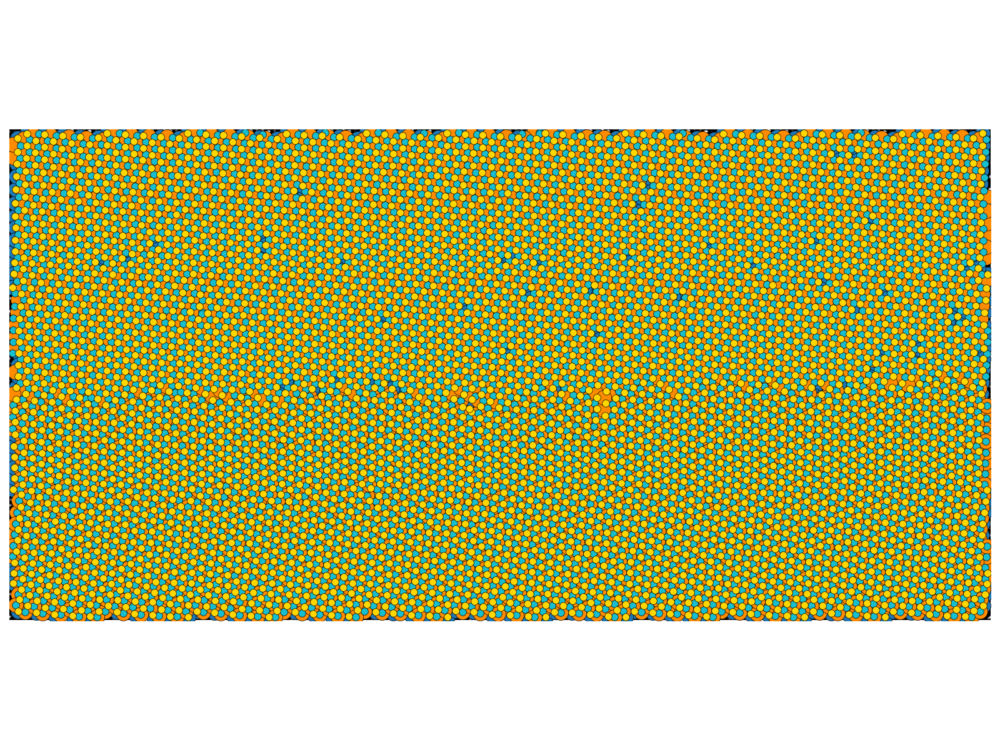

In [54]:
from scipy.spatial import cKDTree

# Parameters
radius = 40  # distance threshold for drawing lines
master_alpha = 1

fig, ax = plt.subplots(1, 1, figsize=(16, 12))
ax.imshow(final_image, cmap='gray', vmax = 0.6)


# Bottom scatter
marker = 'o'
size = 300
ax.scatter(Mo_bottom_right[:, 1], Mo_bottom_right[:, 0], s=size, c='tab:blue', alpha=master_alpha, marker=marker, zorder=2, edgecolors='k', linewidths=0.5)
ax.scatter(Mo_bottom_left[:, 1],  Mo_bottom_left[:, 0],  s=size, c='tab:blue', alpha=master_alpha, marker=marker, zorder=2, edgecolors='k', linewidths=0.5)
ax.scatter(S_bottom_right[:, 1], S_bottom_right[:, 0], s=size, c='darkorange', alpha=master_alpha, marker=marker, zorder=2, edgecolors='k', linewidths=0.5)
ax.scatter(S_bottom_left[:, 1],  S_bottom_left[:, 0],  s=size, c='darkorange', alpha=master_alpha, marker=marker, zorder=2, edgecolors='k', linewidths=0.5)


# Top scatter
marker = 'o'
size = 70
ax.scatter(Mo_top_right[:, 1], Mo_top_right[:, 0], s=size, c='tab:cyan', alpha=master_alpha, marker=marker, zorder=2, edgecolors='k', linewidths=0.5)
ax.scatter(Mo_top_left[:, 1],  Mo_top_left[:, 0],  s=size, c='tab:cyan', alpha=master_alpha, marker=marker, zorder=2, edgecolors='k', linewidths=0.5)
ax.scatter(S_top_right[:, 1],  S_top_right[:, 0],  s=size, c='gold', alpha=master_alpha, marker=marker, zorder=2, edgecolors='k', linewidths=0.5)
ax.scatter(S_top_left[:, 1],   S_top_left[:, 0],   s=size, c='gold', alpha=master_alpha, marker=marker, zorder=2, edgecolors='k', linewidths=0.5)

ax.axis('off')
plt.tight_layout()
plt.show()
